Dipta roy

In [107]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from sklearn import feature_extraction, linear_model, model_selection, preprocessing 
from nltk.corpus import stopwords
import re # https://docs.python.org/3/library/re.html

import pandas as pd
import numpy as np
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn')
pd.options.display.max_rows = 4000
pd.set_option('display.max_columns', 100)
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.corpus import stopwords
import nltk
nltk.download('stopwords')
from nltk.stem.porter import PorterStemmer
from wordcloud import WordCloud,STOPWORDS

from nltk.stem import WordNetLemmatizer
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Dipta\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Dipta\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\wordnet.zip.


True

In [58]:
import numpy as np
import pandas as pd

x = pd.read_csv('data_reviews/x_train.csv')
y = pd.read_csv('data_reviews/y_train.csv')
x_test = pd.read_csv('data_reviews/x_test.csv')
# tr_text_list = x['text'].values.tolist()
# for text in tr_text_list:
#     print(text)

df = pd.concat([x,y], axis=1)

In [59]:
x.shape

(2400, 2)

In [60]:
df.shape

(2400, 3)

In [61]:
df.isna().sum()

website_name             0
text                     0
is_positive_sentiment    0
dtype: int64

In [17]:
# Simplest basic tokenizing and counting:
from sklearn.feature_extraction.text import CountVectorizer

count_vectorizer = CountVectorizer()
x_vect = count_vectorizer.fit_transform(x['text'])
# print("Number of features: ", len(x.toarray()[0]))
# print(count_vectorizer.get_feature_names())
# print(x.toarray())
pd.DataFrame(x_vect.toarray(), columns=count_vectorizer.get_feature_names())

,00,10,100,11,12,13,15,15g,15pm,17,18,18th,1928,1948,1971,1973,1979,1980,1986,1995,1998,20,2000,2007,20th,2160,24,25,30,30s,325,35,350,375,3o,40,40min,42,44,45,4s,4ths,50,5020,510,5320,54,5lb,680,70,...,worse,worst,worth,worthless,worthwhile,worthy,would,wouldn,wouldnt,wound,woven,wow,wrap,wrapped,write,writer,writers,writing,written,wrong,wrongly,wrote,ya,yama,yawn,yeah,year,years,yell,yellow,yellowtail,yelpers,yes,yet,you,young,younger,your,yourself,youthful,youtube,yucky,yukon,yum,yummy,yun,z500a,zero,zillion,zombie
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## Baseline using count vectorization and Linear Regression without any data prep

In [6]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)

In [7]:
X_train.columns

Index(['website_name', 'text'], dtype='object')

In [8]:
y_test

,is_positive_sentiment
2037,1
1978,0
855,0
1719,0
2019,1
...,...
30,0
1171,0
1996,0
746,1


In [9]:
train_vectors = count_vectorizer.fit_transform(X_train["text"])
# test_vectors = count_vectorizer.transform(y_test["text"])

In [10]:
test_vectors = count_vectorizer.transform(X_test["text"])

In [11]:
clf = linear_model.RidgeClassifier()

In [12]:
scores = model_selection.cross_val_score(clf, train_vectors, y_train["is_positive_sentiment"], cv=3, scoring="f1")
scores

array([0.76748582, 0.75614367, 0.81343284])

In [13]:
train_vectors = count_vectorizer.fit_transform(x["text"])
# test_vectors = count_vectorizer.transform(y_test["text"])

In [14]:
clf.fit(train_vectors, y["is_positive_sentiment"])

RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=None,
                solver='auto', tol=0.001)

In [15]:
sub = pd.read_csv("data_reviews/x_test.csv")

In [16]:
sub

,website_name,text
0,imdb,"Technically, the film is well made with impres..."
1,yelp,!....THE OWNERS REALLY REALLY need to quit bei...
2,amazon,what a disappointment
3,imdb,The movie is terribly boring in places.
4,imdb,"One of the best mexican movies ever!, and one ..."
...,...,...
595,yelp,This is a great restaurant at the Mandalay Bay.
596,yelp,I could care less... The interior is just beau...
597,imdb,The only consistent thread holding the series ...
598,yelp,My side Greek salad with the Greek dressing wa...


In [17]:
sub_vec = count_vectorizer.transform(sub['text'])

In [18]:
yproba1_test = clf.predict(sub_vec)
np.savetxt('yproba1_test.txt', yproba1_test)

## Data Preprocessing

[Text(0.5, 1.0, 'Class Balance')]

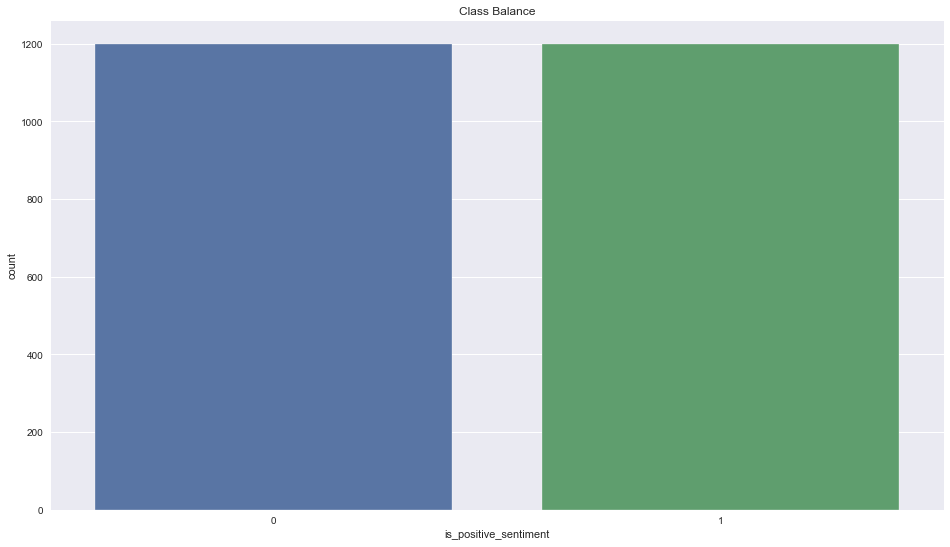

In [19]:
plt.figure(figsize = (16, 9))
sns.set_style("darkgrid")  #checked to see visual of balance between True & Fake articles
sns.countplot(y.is_positive_sentiment).set(title = "Class Balance")

In [44]:
df.isna().sum()

website_name             2400
text                     2400
is_positive_sentiment    2400
dtype: int64

### BAG OF WORDS

In [33]:
from sklearn.feature_extraction.text import CountVectorizer

In [34]:
count_vectorizer = CountVectorizer()
x = count_vectorizer.fit_transform(x.text)
print("Features: ", count_vectorizer.get_feature_names())

analyze = count_vectorizer.build_analyzer()
print([analyze(s) for s in x.text])

Features:  ['00', '10', '100', '11', '12', '13', '15', '15g', '15pm', '17', '18', '18th', '1928', '1948', '1971', '1973', '1979', '1980', '1986', '1995', '1998', '20', '2000', '2007', '20th', '2160', '24', '25', '30', '30s', '325', '35', '350', '375', '3o', '40', '40min', '42', '44', '45', '4s', '4ths', '50', '5020', '510', '5320', '54', '5lb', '680', '70', '70000', '700w', '80', '80s', '8125', '85', '8525', '8530', '8pm', '90', '95', '99', 'abandoned', 'abhor', 'ability', 'able', 'abound', 'about', 'above', 'abroad', 'absolute', 'absolutel', 'absolutely', 'absolutley', 'abstruse', 'abysmal', 'ac', 'academy', 'accents', 'accept', 'acceptable', 'access', 'accessable', 'accessible', 'accessoryone', 'accident', 'accidentally', 'acclaimed', 'accolades', 'accomodate', 'accompanied', 'accurate', 'accurately', 'accused', 'ache', 'achievement', 'achille', 'ackerman', 'acknowledged', 'act', 'acted', 'acting', 'action', 'actions', 'activate', 'actor', 'actors', 'actress', 'actresses', 'actual', 

AttributeError: text not found

In [10]:
import re, string

In [11]:
re.sub(r"[^0-9\-]", " ", x.text).lower().split()

AttributeError: text not found

In [20]:
from nltk.stem.porter import PorterStemmer

In [17]:
from nltk.corpus import stopwords
import nltk
nltk.download('stopwords')

def stop_stemming_tokenizer(str_input):
    words = re.sub(r"[^A-Za-z]", " ", str_input).lower().split()
    
    # remove stops using nltk
    #
    # NOTE: for demo purposes only! You may well find 
    # that the nltk version of 'english' has issues similar
    # to the version found in sklearn; you may want to use
    # your own custom list of stop-words instead
    stops = stopwords.words('english')
    words = [w for w in words if w not in stops]
    
    # stem the remaining words after removing stops; 
    # what happens if we do this *before* removing stops?
    porter_stemmer = PorterStemmer()
    words = [porter_stemmer.stem(word) for word in words]
    
    return words

count_vectorizer = CountVectorizer(tokenizer=stop_stemming_tokenizer)
x_count = count_vectorizer.fit_transform(x.text)
features = count_vectorizer.get_feature_names()
print("Number of features: ", len(features))
print(features)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Dipta\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.


Number of features:  3404
['abandon', 'abhor', 'abil', 'abl', 'abound', 'abroad', 'absolut', 'absolutel', 'absolutley', 'abstrus', 'abysm', 'ac', 'academi', 'accent', 'accept', 'access', 'accessoryon', 'accid', 'accident', 'acclaim', 'accolad', 'accomod', 'accompani', 'accur', 'accus', 'ach', 'achiev', 'achil', 'ackerman', 'acknowledg', 'act', 'action', 'activ', 'actor', 'actress', 'actual', 'ad', 'adapt', 'add', 'addit', 'adhes', 'admin', 'admit', 'ador', 'adrift', 'adventur', 'advertis', 'advis', 'aerial', 'aesthet', 'affect', 'affleck', 'afford', 'afraid', 'africa', 'afternoon', 'age', 'ago', 'agre', 'ahead', 'aimless', 'air', 'airlin', 'akin', 'ala', 'alarm', 'albondiga', 'alexand', 'alik', 'allot', 'allow', 'almond', 'almost', 'alon', 'along', 'alongsid', 'alot', 'alreadi', 'also', 'although', 'aluminum', 'alway', 'amateurish', 'amaz', 'amazingli', 'amazon', 'ambianc', 'ambienc', 'america', 'american', 'among', 'amount', 'amp', 'ampl', 'amus', 'anatomist', 'andddd', 'angel', 'ange

In [18]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [19]:
# By setting use_idf=False (default is True), we don't pay attention 
# to the amount that each word occurs in the overall set of documents.
tf_vectorizer = TfidfVectorizer(tokenizer=stop_stemming_tokenizer, use_idf=False)
x = tf_vectorizer.fit_transform(x.text)
pd.DataFrame(x.toarray(), columns=tf_vectorizer.get_feature_names())

,abandon,abhor,abil,abl,abound,abroad,absolut,absolutel,absolutley,abstrus,...,youtub,yucki,yukon,yum,yummi,yun,z,zero,zillion,zombi
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2395,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2396,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2397,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2398,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [21]:
x

<2400x3404 sparse matrix of type '<class 'numpy.float64'>'
	with 14190 stored elements in Compressed Sparse Row format>

In [ ]:
def tokenizer(str_input):
    words = re.sub(r"[^A-Za-z]", " ", str_input).lower().split()
    
    # remove stops using nltk
    #
    # NOTE: for demo purposes only! You may well find 
    # that the nltk version of 'english' has issues similar
    # to the version found in sklearn; you may want to use
    # your own custom list of stop-words instead
    stops = stopwords.words('english')
    words = [w for w in words if w not in stops]
    
    # stem the remaining words after removing stops; 
    # what happens if we do this *before* removing stops?
    porter_stemmer = PorterStemmer()
    words = [porter_stemmer.stem(word) for word in words]
    
    return words

In [36]:
def get_corpus(text):
    words = []
    for i in text:
        for j in i.split():
            words.append(j.strip().lower())
    return words
corpus = get_corpus(x.text)
corpus[:5]

['oh', 'and', 'i', 'forgot', 'to']

In [42]:
from collections import Counter  #checked to see how many times the top 10 most frequent words were in the articles
counter = Counter(corpus)
most_common = counter.most_common(200)
most_common = dict(most_common)
most_common.keys()

dict_keys(['the', 'and', 'a', 'i', 'is', 'to', 'of', 'this', 'was', 'it', 'in', 'for', 'not', 'that', 'with', 'my', 'very', 'on', 'you', 'but', 'have', 'are', 'good', 'so', 'as', 'great', 'be', 'movie', 'at', 'had', 'phone', 'one', 'all', 'like', 'were', 'an', 'just', 'film', 'if', 'we', "it's", 'they', 'there', 'really', 'from', 'place', 'would', 'food', 'has', 'about', 'out', 'it.', 'your', 'even', 'only', 'or', "don't", 'time', 'by', '-', 'no', 'service', 'will', 'ever', 'bad', 'than', 'best', 'also', 'when', 'what', 'he', 'go', 'because', 'can', 'love', 'which', 'some', 'up', 'more', "i'm", "i've", 'get', 'his', 'could', 'recommend', 'been', 'how', 'who', 'our', 'works', 'make', 'do', 'better', 'after', 'quality', 'made', 'excellent', 'here', 'any', "didn't", 'well', 'their', 'me', 'most', 'much', 'first', 'think', 'did', 'back', 'other', 'sound', 'its', 'never', 'see', 'still', 'nice', 'pretty', 'every', 'little', 'battery', 'work', 'now', 'way', 'being', 'use', 'too', 'phone.', '

In [44]:
def get_top_text_ngrams(corpus, n, g):
    vec = CountVectorizer(ngram_range = (g, g)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis = 0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key = lambda x: x[1], reverse = True)
    return words_freq[:n]

In [45]:
get_top_text_ngrams(x.text, 6, 2)  #testing out function

[('of the', 135),
 ('and the', 91),
 ('in the', 91),
 ('it was', 79),
 ('it is', 75),
 ('this is', 74)]

## Now taking off the stop words because it looks like there are a lot of stop words 

In [49]:
# stop = set(stopwords.words('english'))
# punctuation = list(string.punctuation)
# stop.update(punctuation)

In [62]:
stop = ['the', 'and', 'a', 'i', 'is', 'to', 'of', 'this', 'was', 'it', 'in', 'for', 'that', 'with', 'my', 'very', 'on', 'you', 'but', 'have', 'are',  'an', 'just'
       ,'if', 'we', "it's", 'they', 'there', 'really', 'from','has', 'about', 'your', 'even', 'only', 'or', 'when', 'what', 'he', 'go', 'because'
       ,'which', 'some', 'up', 'how', 'who', 'our', 'after','their', 'me', 'did', 'its', 'see', 'still',  'battery','got', 'am',  'does', 'them', 'two', 'going'
       , '&', 'look', 'plot', 'story','i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 
        'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 
        'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being',
        'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after']

In [57]:
print(stopwords.words('english'))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [63]:
def remove_stopwords(text):
    final_text = []
    for i in text.split():
        if i.strip().lower() not in stop:
            final_text.append(i.strip())
    return " ".join(final_text)

In [67]:
x['clean'] = x['text'].apply(lambda x: remove_stopwords(x))

In [69]:
x

,website_name,text,clean
0,amazon,Oh and I forgot to also mention the weird colo...,Oh forgot also mention weird color effect phone.
1,amazon,THAT one didn't work either.,one didn't work either.
2,amazon,Waste of 13 bucks.,Waste 13 bucks.
3,amazon,"Product is useless, since it does not have eno...","Product useless, since not enough charging cur..."
4,amazon,None of the three sizes they sent with the hea...,None three sizes sent headset would stay ears.
5,amazon,Worst customer service.,Worst customer service.
6,amazon,The Ngage is still lacking in earbuds.,Ngage lacking earbuds.
7,amazon,It always cuts out and makes a beep beep beep ...,always cuts out makes beep beep beep sound the...
8,amazon,the only VERY DISAPPOINTING thing was there wa...,DISAPPOINTING thing NO SPEAKERPHONE!!!!
9,amazon,Very disappointed in AccessoryOne.,disappointed AccessoryOne.


In [98]:
def stop_stemming_tokenizer(str_input):
    words = re.sub(r"[^A-Za-z0-9\-\\]", " ", str_input).lower().split()
    
    # remove stops using nltk
    #
    # NOTE: for demo purposes only! You may well find 
    # that the nltk version of 'english' has issues similar
    # to the version found in sklearn; you may want to use
    # your own custom list of stop-words instead
    words = [w for w in words if w not in stop]
    
    # stem the remaining words after removing stops; 
    # what happens if we do this *before* removing stops?
    porter_stemmer = PorterStemmer()
    words = [porter_stemmer.stem(word) for word in words]
    
    return words

count_vectorizer = CountVectorizer(tokenizer=stop_stemming_tokenizer)
x_count = count_vectorizer.fit_transform(x.text)
features = count_vectorizer.get_feature_names()
print(len(features))

3620


In [85]:
features

['-',
 '--',
 '-drink',
 '-good',
 '-mi',
 '0',
 '00',
 '1',
 '1-10',
 '10',
 '100',
 '11',
 '12',
 '13',
 '15',
 '15g',
 '15pm',
 '17',
 '18',
 '18th',
 '1928',
 '1948',
 '1971',
 '1973',
 '1979',
 '1980',
 '1986',
 '1995',
 '1998',
 '2',
 '2-3',
 '20',
 '2000',
 '2007',
 '20th',
 '2160',
 '24',
 '25',
 '3',
 '30',
 '325',
 '35',
 '350',
 '375',
 '3o',
 '4',
 '40',
 '40min',
 '44',
 '45',
 '4s',
 '4th',
 '5',
 '5-year',
 '50',
 '5020',
 '510',
 '5320',
 '54',
 '5lb',
 '680',
 '7',
 '70',
 '70000',
 '700w',
 '8',
 '80',
 '8125',
 '85',
 '8525',
 '8530',
 '8pm',
 '9',
 '90',
 '95',
 '99',
 'abandon',
 'abhor',
 'abil',
 'abl',
 'abound',
 'abov',
 'abroad',
 'absolut',
 'absolutel',
 'absolutley',
 'abstrus',
 'abysm',
 'ac',
 'academi',
 'accent',
 'accept',
 'access',
 'accessoryon',
 'accid',
 'accident',
 'acclaim',
 'accolad',
 'accomod',
 'accompani',
 'accur',
 'accus',
 'ach',
 'achiev',
 'achil',
 'ackerman',
 'acknowledg',
 'act',
 'acting--even',
 'acting-wis',
 'action',
 'a

In [70]:
get_top_text_ngrams(x.clean, 6, 3)

[('would not recommend', 7),
 ('don waste time', 5),
 ('ve ever seen', 4),
 ('will never ever', 4),
 ('make same mistake', 3),
 ('don waste money', 3)]

In [77]:
corpus = get_corpus(x.clean)

In [79]:
counter = Counter(corpus)
most_common = counter.most_common(10)
most_common = dict(most_common)
most_common

{'good': 125,
 'movie': 105,
 'phone': 93,
 'one': 92,
 'film': 87,
 'great': 78,
 'place': 74,
 'really': 71,
 'it.': 66,
 'food': 64}

In [91]:
df

,website_name,text,is_positive_sentiment
0,amazon,Oh and I forgot to also mention the weird colo...,0
1,amazon,THAT one didn't work either.,0
2,amazon,Waste of 13 bucks.,0
3,amazon,"Product is useless, since it does not have eno...",0
4,amazon,None of the three sizes they sent with the hea...,0
5,amazon,Worst customer service.,0
6,amazon,The Ngage is still lacking in earbuds.,0
7,amazon,It always cuts out and makes a beep beep beep ...,0
8,amazon,the only VERY DISAPPOINTING thing was there wa...,0
9,amazon,Very disappointed in AccessoryOne.,0


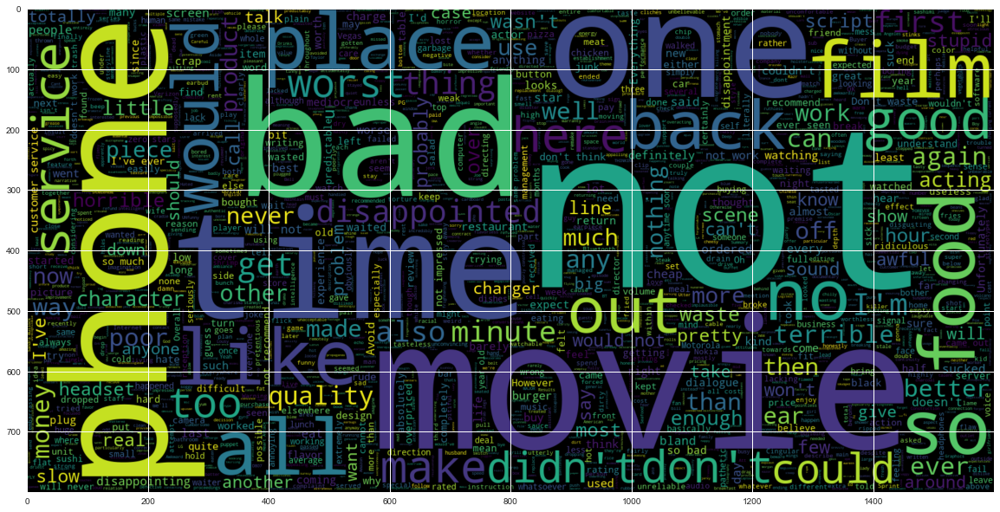

In [93]:
plt.figure(figsize = (20,20)) # Text that is True
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , stopwords = stop).generate(" ".join(df[df.is_positive_sentiment == 0].text))
plt.imshow(wc , interpolation = 'bilinear')

In [97]:
count_vectorizer = CountVectorizer(tokenizer=stop_stemming_tokenizer, ngram_range=(2,2))
x_count = count_vectorizer.fit_transform(x.text)
features = count_vectorizer.get_feature_names()
len(features)

12181

In [108]:
def stop_lema(str_input):
    words = re.sub(r"[^A-Za-z]", " ", str_input).lower().split()
    
    # remove stops using nltk
    #
    # NOTE: for demo purposes only! You may well find 
    # that the nltk version of 'english' has issues similar
    # to the version found in sklearn; you may want to use
    # your own custom list of stop-words instead
#     stops = stopwords.words('english')
    words = [w for w in words if w not in stop]
    
    # stem the remaining words after removing stops; 
    # what happens if we do this *before* removing stops?
    lemmatizer = WordNetLemmatizer()
    words = [lemmatizer.lemmatize(word) for word in words]

    
    return words

In [109]:
tfidf_vectorizer = TfidfVectorizer(tokenizer=stop_lema, ngram_range=(2,2))
x = tfidf_vectorizer.fit_transform(x.text)
pd.DataFrame(x.toarray(), columns=tfidf_vectorizer.get_feature_names())

,abandoned factory,ability actually,ability dwight,ability meld,ability pull,able roam,able use,able voice,above all,above average,above beyond,above ear,above pretty,above script,abroad interacting,absolute must,absolutel junk,absolutely abysmal,absolutely amazing,absolutely appalling,absolutely back,absolutely delicious,absolutely flat,absolutely great,absolutely hilarious,absolutely loved,absolutely no,absolutely nothing,absolutely recommend,absolutely star,absolutley fantastic,abstruse culture,ac charger,academy award,accent absolutely,accept anything,access fine,access phone,accessible film,accident could,accidentally activate,accidentally touch,acclaimed novella,accolade especially,accomodate vegan,accompanied software,accurate portrayal,accurately defined,accused murder,accused murdering,...,yeah suck,year ago,year amazed,year carry,year childhood,year down,year earlier,year fliptop,year great,year however,year left,year living,year mark,year now,year old,year one,year probably,year seriously,year went,year working,yell talk,yellow saffron,yellowtail carpaccio,yelpers husband,yes film,yes simplifying,yet another,yet delicious,yet enjoy,yet hear,yet run,yet sequel,yet serious,young judge,young man,young movie,younger set,youthful energy,yukon gold,yum sauce,yum yum,yummy try,yummy tummy,yun fat,z m,z note,zero star,zero taste,zillion time,zombie movie
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0

### Logistic Regression